code adapted from 
code/MNF/notebooks/STRING_Data_11.5/transitivity_and_LongRangDCAProblem.ipynb

In [2]:

import os
import sys
import pickle
import copy
import numpy as np 
import pandas as pd
from collections import defaultdict
import multiprocessing as mp 


import seaborn as sns
import matplotlib.pyplot as plt 





In [3]:
%reload_ext autoreload
%autoreload 2

sys.path.append('../src/utilities/')


from collect_topCoEvos import get_pydcaFNAPC_betArray
from collect_topCoEvos import get_topRanking_CoEvo_file
# from collect_topCoEvos import get_pydcaFNAPC_IntraArrayandBetArray_max
from collect_topCoEvos import get_topRankingBetValue_dict_PosInSingleMSA_framArray

from pdb_benchmark import get_STRING1105_pdb_interact
# from pdb_benchmark import get_filter_pdbBenchmark
# from pdb_benchmark import add_pdbstatus
# from pdb_benchmark import add_pdbstatus_fromPosFrame

# from STRING_benchmark import  get_STRING1105_physical_interact
# from STRING_benchmark import  add_STRINGPhyPPI_status



from processANDvisulise_PDB import show_pdb
from processANDvisulise_PDB import map_topRankingBetValue_list_to_realPDB_CACoords
from processANDvisulise_PDB import get_pdb_stuc_chainRes_dict

from py3Dmol_functions import py3Dmol_addLines


In [4]:
Query_tuple=('1224', '511145')
Subject_tupleList=[("1239","1274374"),('201174', '105422'), ('976', '411476'),]

In [5]:
notebookData_folder="/mnt/mnemo6/tao/notebook_data/"  #"/mnt/mnemo6/tao/"

In [6]:
CoEvo_data_folder=f"{notebookData_folder}PPI_Coevolution/CoEvo_data_STRING"+"11.5"+"/"
Query_input_root_folder=CoEvo_data_folder+"allPPI_"+Query_tuple[1]+"_EggNOGmaxLevel"+Query_tuple[0]+"_eggNOGfilteredData/"
Query_Benchmark_folder=Query_input_root_folder+"STRINGFullPhyBalancePhyla_Benchmark/"
Query_ML_inputPath=Query_Benchmark_folder+"ML_inputs/"

Query_DCA_coevolutoin_path=Query_input_root_folder+"coevolutoin_result_DCA/"

newSTRING_rootFolder=f"{notebookData_folder}PPI_Coevolution/STRING_data_11.5/"
Query_ML_inputPath

'/mnt/mnemo6/tao/notebook_data/PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/STRINGFullPhyBalancePhyla_Benchmark/ML_inputs/'

In [9]:
pdb_interact_PPs,pdb_complex_PPs,pdb_complexAndinteract_PPs=get_STRING1105_pdb_interact(pdb_interact_filename=f"{notebookData_folder}STRING_derived_v11.5/pdb/pdb_interact.tsv",
                                retrieve_spe=511145,return_overlap=True)




pdb_interact_PPs_dict={pp: 1 for pp in pdb_interact_PPs}
pdb_complex_PPs_dict={pp: 1 for pp in pdb_complex_PPs}
pdb_PPs_dict={pp: 1 for pp in pdb_interact_PPs+pdb_complex_PPs}



print(len(pdb_interact_PPs),len(pdb_complex_PPs),len(pdb_PPs_dict))


print(len(set(pdb_interact_PPs).intersection(pdb_complex_PPs)))

print(len(set(pdb_interact_PPs).union(pdb_complex_PPs)))

print(len(pdb_complexAndinteract_PPs))
pdb_complexAndinteract_PPs_dict={pp:1 for pp in pdb_complexAndinteract_PPs}

len of intersection: 309
414 3243 3657
0
3657
309


In [10]:

# read protein name file 
ecoli_proteinNames=pd.read_csv(f"{notebookData_folder}STRING_Data_11/511145.protein.info.v11.0.txt",
                              header=0,index_col=None, sep="\t")
print(ecoli_proteinNames.shape)
#ecoli_proteinNames.head(n=3)

ecoli_proteinNames_dict=dict(ecoli_proteinNames.loc[:,["protein_external_id","preferred_name"]].values.tolist())

ecoli_proteinNames.head(n=3)


(4127, 4)


,protein_external_id,preferred_name,protein_size,annotation
0,511145.b0001,thrL,21,Thr operon leader peptide; This protein is inv...
1,511145.b0002,thrA,820,Bifunctional: aspartokinase I (N-terminal); ho...
2,511145.b0003,thrB,310,Homoserine kinase; Catalyzes the ATP-dependent...


# STRING 11.5, phylum 1224, species 511145

In [11]:
Query_currentSpeMiddleDataPath=newSTRING_rootFolder+Query_tuple[1]+"_EggNOGmaxLevel"+Query_tuple[0]+"_MiddleData/"
with open(Query_currentSpeMiddleDataPath+'fasta_protein_lens_dict.pickle', 'rb') as handle:
    Query_fasta_protein_lens=pickle.load(handle) 

In [22]:

Query_allPPI_allInfo_frame=pd.read_csv(f"{notebookData_folder}PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/AllPPI_Benchmark/"+"allPPI_allInfo_frame.csv",
                                 header=0,index_col=None,sep="\t")
print(Query_allPPI_allInfo_frame.shape)
Query_allPPI_allInfo_frame.head(n=3)

(2269192, 4)


,STRING_ID1,STRING_ID2,len1,len2
0,511145.b2547,511145.b4214,494,243
1,511145.b1913,511145.b3965,600,363
2,511145.b1771,511145.b2074,310,399


In [23]:
%%time 

Query_allPPI_info=Query_allPPI_allInfo_frame.loc[:,["STRING_ID1","STRING_ID2","len1","len2"]].values.tolist()

Query_allPPI_allInfo_dict=dict([((p1,p2),(len1,len2)) for p1,p2,len1,len2 in Query_allPPI_info])


# CPU times: user 2.1 s, sys: 361 ms, total: 2.46 s
# Wall time: 15.1 s


CPU times: user 3.05 s, sys: 218 ms, total: 3.27 s
Wall time: 3.27 s


In [24]:
Query_topRanking_DCA_file=f"{notebookData_folder}PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/AllPPI_Benchmark/"+"DCA_thres_"+str(0)+"_topRanking_pydcaFNAPC_frame.csv" 
print(Query_topRanking_DCA_file)


/mnt/mnemo6/tao/notebook_data/PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/AllPPI_Benchmark/DCA_thres_0_topRanking_pydcaFNAPC_frame.csv




module load hpc
conda activate py37_base
sbatch  /home/cluster/tfang/MNF/notebooks/ScienceCluster_code/STRING_Data_11.5/collect_allPPI_topDCAs.sh




In [25]:
%%time 

#if already run in in batch format, here dont need to recollect and rewrite results but just read alreayd saved results ?

Query_top_DCA_dict=get_topRanking_CoEvo_file(topRanking_CoEvo_file=Query_topRanking_DCA_file,
                                               coevolutoin_path=Query_DCA_coevolutoin_path,
                                               coevo_suffix="_pydcaFNAPC_array",
                                               allPPI_info=Query_allPPI_info, #, # [0:3] ,[0:1000],[0:10000]
                                               returnDic=True,
#                                                overwrite=True,
                                            overwrite=False,
                                            use_multiprocessing=10#False
                                              )

# top_CoEvo_frame.shape: (2269192, 152)
# sys.getsizeof(top_CoEvo_list)/(1024*1024*1024):0.016906864941120148
# CPU times: user 1min 21s, sys: 2min 48s, total: 4min 10s
# Wall time: 6min 3s


top_CoEvo_frame.shape: (2269192, 152)
sys.getsizeof(top_CoEvo_list)/(1024*1024*1024):0.016906850039958954
CPU times: user 48.4 s, sys: 6.33 s, total: 54.8 s
Wall time: 57.4 s


# check transitivity problem 

data from http://localhost:8206/lab/workspaces/auto-r/tree/code/MNF/notebooks/STRING_Data_11.5/test_withLowDCA_phylumeffect_STRINGFullPhyBalancePhyla_visulization_fullHomologous_oneBestHomologousPP.ipynb

In [12]:
def fracOfHighDCA(DCAs,dca_thres=1):
    Subject_frac=np.sum(DCAs[:,0:5]>dca_thres,axis=1)/5
    Query_frac=np.sum(DCAs[:,5:]>dca_thres,axis=1)/15
    print(Subject_frac.shape,Query_frac.shape)
    return(Subject_frac,Query_frac)


def get_dcaStatusInPhyla(DCAs,dca_thres=1,highFrac_thres=0.2):
    Subject_frac,Query_frac=fracOfHighDCA(DCAs,dca_thres=dca_thres)
    dcaStatusInPhyla_list=list()
    for i in range(Subject_frac.shape[0]):
        if (Subject_frac[i]<=highFrac_thres) and (Query_frac[i]<=highFrac_thres):
            dcaStatusInPhyla_list.append("LowSubjectLowSub")
        elif (Subject_frac[i]<=highFrac_thres) and (Query_frac[i]>highFrac_thres):
            dcaStatusInPhyla_list.append("LowSubjectHighSub")
        elif (Subject_frac[i]>highFrac_thres) and (Query_frac[i]<=highFrac_thres):
            dcaStatusInPhyla_list.append("HighSubjectLowSub")
        elif (Subject_frac[i]>highFrac_thres) and (Query_frac[i]>highFrac_thres):
            dcaStatusInPhyla_list.append("HighSubjectHighSub")
    return(dcaStatusInPhyla_list)
    
    

In [13]:
transitivity_frame=pd.read_csv(\
os.path.join(Query_Benchmark_folder,
    f"STRING115EggNog1224Spe511145_uniquePhyla_BestHomologousDCAs_top5DCAs_predicted_results_fixedNegVSposRratio_keepCombination_allPPI_allInfo_frame.csv"),
header=0,index_col=None)
# transitivity_frame=copy.deepcopy(saved_STRING115EggNog1224Spe511145_uniquePhyla_BestHomologousDCAs_top5DCAs_predicted_results_fixedNegVSposRratio_keepCombination['updated_allPPI_allInfo_frame'])


##  check if for pdb_complex, if strong DCA are in interface , to see if these top DCA are most strong correlated residue pairs selected by global model ??



In [14]:
from Bio import AlignIO
pairedMSA_Nf90_folder = Query_input_root_folder+"pair_MSA_Nf90_PasteAlign/"
pairedMSA_Nf90_folder

tripleMSA_Nf90_folder = Query_input_root_folder+"triple_MSA_Nf90_PasteAlign/"
tripleMSA_Nf90_folder

tripleMSA_DCA_coevolutoin_path=f"{notebookData_folder}PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/tripleMSA_coevolutoin_result_DCA/"

tripleMSA_DCA_coevolutoin_path


'/mnt/mnemo6/tao/notebook_data/PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/tripleMSA_coevolutoin_result_DCA/'

In [15]:



Query_msa_trackGapsPos_path=newSTRING_rootFolder+Query_tuple[1]+"_EggNOGmaxLevel"+Query_tuple[0]+"_newSingleMSA_hmmalign_removeGaps_trackGapPos/"   


Query_msa_trackGapsPos_path



'/mnt/mnemo6/tao/notebook_data/PPI_Coevolution/STRING_data_11.5/511145_EggNOGmaxLevel1224_newSingleMSA_hmmalign_removeGaps_trackGapPos/'

In [16]:
transitivity_frame_PPs=transitivity_frame.loc[:,["STRING_ID1","STRING_ID2"]].values.tolist()
Query_allProteins=set([p for pp in transitivity_frame_PPs for p in pp])
print(len(Query_allProteins))


# # run once 
# Query_allProteins_msa2orig_dict=dict()
# for Query_pro in Query_allProteins:
#     Query_pro_trackGapsPos_file=Query_msa_trackGapsPos_path+Query_pro+'_allSeq_keptAA_posInOrigalPro.pickle'
#     if os.path.exists(Query_pro_trackGapsPos_file): # not all protein passed filtering step to final paired MSA 
#         with open(Query_pro_trackGapsPos_file, 'rb') as handle:
#             protein_posTrack=pickle.load(handle)
#         protein_origPos=protein_posTrack[0][1]
#         Query_allProteins_msa2orig_dict[Query_pro]=dict(zip(range(len(protein_origPos)),protein_origPos))
    
#     else:
#         Query_allProteins_msa2orig_dict[Query_pro]=None
        
# with open(Query_Benchmark_folder+"STRINGPhyPPI_SubSpeAllPPI"+Query_tuple[1]+"_allProteins_msa2orig_dict.pickle", 'wb') as handle:
#         pickle.dump(Query_allProteins_msa2orig_dict,handle)


1057


In [17]:
'511145.b0158' in Query_allProteins

False

In [18]:
with open(Query_Benchmark_folder+"STRINGPhyPPI_SubSpeAllPPI"+Query_tuple[1]+"_allProteins_msa2orig_dict.pickle", 'rb') as handle:
        Query_allProteins_msa2orig_dict=pickle.load(handle)
        
print("len(Query_allProteins_msa2orig_dict):",len(Query_allProteins_msa2orig_dict))

len(Query_allProteins_msa2orig_dict): 1057


### example  5mrw

In [19]:
pdb_file="/mnt/mnemo6/tao/pdb_data/5MRW.pdb"
pro_stuc_chainRes=get_pdb_stuc_chainRes_dict(pdb_file,selected_chainIDs=["A","B","C","D"])



A
A 561
B
B 676
C
C 187
D
D 27
E
F
G
H
I
J
K
L


/mnt/mnemo5/tao/anaconda3/envs/py38_notebook/lib/python3.8/site-packages/Bio/PDB/StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 66402.
  warnings.warn(
/mnt/mnemo5/tao/anaconda3/envs/py38_notebook/lib/python3.8/site-packages/Bio/PDB/StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 66608.
  warnings.warn(
/mnt/mnemo5/tao/anaconda3/envs/py38_notebook/lib/python3.8/site-packages/Bio/PDB/StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 66648.
  warnings.warn(
/mnt/mnemo5/tao/anaconda3/envs/py38_notebook/lib/python3.8/site-packages/Bio/PDB/StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 66772.
  warnings.warn(
/mnt/mnemo5/tao/anaconda3/envs/py38_notebook/lib/python3.8/site-packages/Bio/PDB/StructureBuilder.py:89: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 66854.
  warnings.warn(
/mnt/mnemo5/tao/anaconda3

In [20]:
topDCA_num=20

radius=0.5
edge_colors=["black","black","black",]#["red","yellow","blue",]

# protein_colors=None#["gray","black","black"]

protein_colors=["#abd9e9","#fdae61","#ffffbf","green"]#["gray","black","black"]




plt.figure()
pdb_view=show_pdb(pdb_file=pdb_file,
         selected_chains=["A","B","C","D"],  #["A","B","C","D"],  
        hiden_chainList=["E","F","G","H","I","J","K","L",],
        colors=protein_colors,
                 )


pdb_view.zoom(1.2,0)# second one seems is time delay, first one is zoom in or out 
# here rotation reisude pairs, the left , middle right in the msa are same as in pdb figure ?
pdb_view.show()


chain A use colorscheme #abd9e9
chain B use colorscheme #fdae61
chain C use colorscheme #ffffbf
chain D use colorscheme green


You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

<Figure size 640x480 with 0 Axes>

In [26]:
topDCA_num=20

radius=0.5
edge_colors=["black","black","black",]#["red","yellow","blue",]

protein_colors=None#["gray","black","black"]

pp_list=[('511145.b0696', '511145.b0697'),('511145.b0696', '511145.b0698'),('511145.b0697','511145.b0698')]
cc_list=[("C","B"),("C","A"),("B","A")]# chain info get from pdb website and string db website 

# for i in range(len(pp_list)): 



for i in range(len(pp_list)): 
    plt.figure()
    pdb_view=show_pdb(pdb_file=pdb_file,
             selected_chains=["A","B","C","D"],  
            hiden_chainList=["E","F","G","H","I","J","K","L",],
            colors=protein_colors,
                     )
    pp=pp_list[i]
    p1,p2=pp
    chain_pair=cc_list[i]
    color=edge_colors[i]
    topDCA_list=Query_top_DCA_dict[pp][0:(3*topDCA_num)]
    topDCA_tupleList=[tuple(topDCA_list[(3*i):(3*i+3)]) for i in range(int(len(topDCA_list)/3))]
    topDCA_inSingleMSA_tupleList=[(t1,t2,t3-Query_fasta_protein_lens[p1]) for t1,t2,t3 in topDCA_tupleList]
    topDCA_inOriProtein_tupleList=[(t1,Query_allProteins_msa2orig_dict[p1][t2],Query_allProteins_msa2orig_dict[p2][t3]) for t1,t2,t3 in topDCA_inSingleMSA_tupleList]
    topDCA_inOriProtein_List=[i for t in topDCA_inOriProtein_tupleList for i in t]
    print(pp,chain_pair,topDCA_inOriProtein_List)

    start_coords_list,end_coords_list=map_topRankingBetValue_list_to_realPDB_CACoords(topDCA_inOriProtein_List,pro_stuc_chainRes,chainList=chain_pair)


    print(color)
    pdb_view=py3Dmol_addLines(pdb_view,start_coords_list,end_coords_list,
                              color,radius=radius
                             )

    pdb_view.zoom(1.2,0)# second one seems is time delay, first one is zoom in or out 
    # here rotation reisude pairs, the left , middle right in the msa are same as in pdb figure ?
    pdb_view.show()

    
# 4 ('511145.b0696', '511145.b0697') 1.0869 ('511145.b0696', '511145.b0698') 3.678 PDB_5mrw_complex
# 4 ('511145.b0696', '511145.b0697') 1.0869 ('511145.b0697', '511145.b0698') 1.3823 PDB_5mrw_complex

chain A use colorscheme purple	
chain B use colorscheme blue
chain C use colorscheme red
chain D use colorscheme green
('511145.b0696', '511145.b0697') ('C', 'B') [1.0869, 152, 626, 0.9866, 81, 78, 0.9119, 89, 616, 0.9025, 25, 199, 0.8852, 108, 510, 0.8374, 130, 287, 0.8294, 63, 566, 0.8256, 29, 573, 0.8252, 131, 19, 0.8248, 19, 385, 0.8233, 11, 8, 0.8121, 10, 79, 0.8105, 92, 225, 0.8085, 122, 313, 0.8028, 183, 479, 0.8011, 11, 417, 0.7943, 71, 181, 0.7931, 121, 184, 0.7718, 172, 212, 0.7693, 148, 608]
black
lines color is black


You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

chain A use colorscheme purple	
chain B use colorscheme blue
chain C use colorscheme red
chain D use colorscheme green
('511145.b0696', '511145.b0698') ('C', 'A') [3.678, 29, 189, 3.6136, 25, 185, 3.1428, 90, 447, 2.8668, 84, 352, 2.2911, 48, 203, 2.1729, 23, 197, 1.7105, 25, 182, 1.6992, 8, 49, 1.6915, 169, 10, 1.654, 28, 182, 1.6383, 54, 243, 1.5179, 174, 248, 1.4531, 10, 75, 1.4254, 174, 324, 1.3656, 12, 45, 1.3398, 25, 189, 1.3066, 94, 307, 1.2827, 14, 130, 1.2648, 82, 243, 1.2622, 79, 214]
black
lines color is black


You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

chain A use colorscheme purple	
chain B use colorscheme blue
chain C use colorscheme red
chain D use colorscheme green
('511145.b0697', '511145.b0698') ('B', 'A') [1.3823, 234, 541, 1.3141, 233, 541, 1.1843, 247, 441, 0.9539, 95, 319, 0.9427, 172, 397, 0.9252, 233, 425, 0.9109, 423, 274, 0.9061, 558, 157, 0.8934, 479, 355, 0.8762, 382, 420, 0.8665, 245, 452, 0.8665, 539, 422, 0.8654, 189, 92, 0.8398, 44, 96, 0.816, 583, 429, 0.8126, 467, 198, 0.8126, 655, 524, 0.8056, 605, 131, 0.8011, 69, 188, 0.7988, 655, 176]
black
lines color is black


You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [27]:
help(pdb_view.setHoverable)

Help on function makejs in module py3Dmol:

makejs(*args, **kwargs)



#### do triple MSA 

4 ('511145.b0696', '511145.b0697') 1.0869 ('511145.b0696', '511145.b0698') 3.678 PDB_5mrw_complex
4 ('511145.b0696', '511145.b0697') 1.0869 ('511145.b0697', '511145.b0698') 1.3823 PDB_5mrw_complex

put 511145.b0698 in the middle of triple MSA as its in the middle in pdb 

In [28]:
# code to prepare triple msa 
left_pro,right_pro,middle_pro=('511145.b0696','511145.b0697','511145.b0698',)
left_proLen,right_proLen,middle_proLen=[Query_fasta_protein_lens[p] for p in ('511145.b0696','511145.b0697','511145.b0698',)]

print(left_proLen,right_proLen,middle_proLen)


msa1_filename=pairedMSA_Nf90_folder+left_pro+"and"+middle_pro+".fasta"
msa1 = AlignIO.read(msa1_filename, "fasta")

msa2_filename=pairedMSA_Nf90_folder+right_pro+"and"+middle_pro+".fasta"
msa2 = AlignIO.read(msa2_filename, "fasta")


msa1_dict=dict()
for seq in msa1:
    #print(seq.name,seq.seq)
    species_id=seq.name.split(".")[0]
    msa1_dict[species_id]=(seq.name,seq.seq)
print(len(msa1_dict))
    
msa2_dict=dict()
for seq in msa2:
    #print(seq.name,seq.seq)
    species_id=seq.name.split(".")[0]
    #print(species_id,seq.name)
    msa2_dict[species_id]=(seq.name,seq.seq)
print(len(msa2_dict))



commonSpes=set()
for spepecies_id,seq in msa1_dict.items():
    if spepecies_id in msa2_dict:
        #print(spepecies_id)
        commonSpes.add(spepecies_id)
commonSpes=list(commonSpes)
print(len(commonSpes))

commonSpes.insert(0, commonSpes.pop(commonSpes.index("511145")))
print(len(commonSpes))

prepend_line=""
for species_id in commonSpes:

    msa1_seqName,msa1_seq=msa1_dict[species_id]
    #print(species_id,msa1_seqName)
    
    msa2_seqName,msa2_seq=msa2_dict[species_id]
    third_proName,third_seq=msa2_seqName.split("and")[0],msa2_seq[0:Query_fasta_protein_lens[right_pro]]
    
    tripleMSA_seqName="and".join([msa1_seqName,third_proName])
    tripleMSA_seq=msa1_seq+third_seq
    
    prepend_line +=">" + tripleMSA_seqName+"\n"+str(tripleMSA_seq)+"\n"
    
len(commonSpes)/np.sqrt(len(tripleMSA_seq))


with open(tripleMSA_Nf90_folder+"and".join([left_pro,middle_pro,right_pro])+".fasta", 'w') as modified: 
    modified.write(prepend_line)
    
    
DCA_l=(left_pro,middle_pro,right_pro,
       left_proLen,middle_proLen,right_proLen,
       tripleMSA_Nf90_folder,
       tripleMSA_DCA_coevolutoin_path
      )
DCA_l

190 680 557
1040
826
685
685


('511145.b0696',
 '511145.b0698',
 '511145.b0697',
 190,
 557,
 680,
 '/mnt/mnemo6/tao/notebook_data/PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/triple_MSA_Nf90_PasteAlign/',
 '/mnt/mnemo6/tao/notebook_data/PPI_Coevolution/CoEvo_data_STRING11.5/allPPI_511145_EggNOGmaxLevel1224_eggNOGfilteredData/tripleMSA_coevolutoin_result_DCA/')

#### compute DCA for trile MSA
http://localhost:8206/lab/workspaces/auto-r/tree/code/MNF/notebooks/STRING_Data_11.5/compute_tripleMSA.ipynb

check why py37_pydca canbe use int jupyter kenrl but not in  linux terminal 




#### processing  DCA results  of trile MSA

resuts from section "## check a complex contain both pdb_contact and pdb_complex"
4 ('511145.b0696', '511145.b0697') 1.0869 ('511145.b0696', '511145.b0698') 3.678 PDB_5mrw_complex
4 ('511145.b0696', '511145.b0697') 1.0869 ('511145.b0697', '511145.b0698') 1.3823 PDB_5mrw_complex

In [25]:
# left_pro,right_pro,middle_pro=('511145.b0696','511145.b0697','511145.b0698',)
# here left right , middle mean position in triple MSA
# chain C B A

In [29]:
tripleMSA_data_fileName=tripleMSA_DCA_coevolutoin_path+"511145.b0696and511145.b0698and511145.b0697_pydcaFNAPC_array.npz"

tripleMSA_data_array_Dig=np.load(tripleMSA_data_fileName)['arr_0']

tripleMSA_data_array =tripleMSA_data_array_Dig.T + tripleMSA_data_array_Dig
#np.fill_diagonal(data_array,data_array_Dig.diagonal())#
np.fill_diagonal(tripleMSA_data_array,0)



tripleMSA_right2middle_Betarray=tripleMSA_data_array[(left_proLen+middle_proLen):,(left_proLen):(left_proLen+middle_proLen)]



In [30]:
topDCA_num=20

In [31]:
# chain C to chain B
tripleMSA_left2right_Betarray=tripleMSA_data_array[0:left_proLen,(left_proLen+middle_proLen):]
tripleMSA_left2right_Betarray_topDCAList=get_topRankingBetValue_dict_PosInSingleMSA_framArray(tripleMSA_left2right_Betarray,topDCA_num)
print(tripleMSA_left2right_Betarray_topDCAList)

pairMSA_left2right_Betarray=get_pydcaFNAPC_betArray(Query_DCA_coevolutoin_path,left_pro,right_pro,left_proLen,"_pydcaFNAPC_array")
pairMSA_left2right_Betarray_topDCAList=get_topRankingBetValue_dict_PosInSingleMSA_framArray(pairMSA_left2right_Betarray,topDCA_num)
print(pairMSA_left2right_Betarray_topDCAList)









[0.7313, 152, 624, 0.73, 15, 440, 0.7188, 48, 114, 0.708, 29, 571, 0.6877, 150, 578, 0.6837, 95, 634, 0.679, 160, 21, 0.674, 132, 439, 0.6727, 66, 298, 0.6714, 167, 398, 0.6687, 16, 385, 0.6663, 31, 398, 0.6561, 34, 672, 0.6561, 48, 242, 0.6548, 75, 417, 0.6518, 115, 656, 0.651, 47, 325, 0.6479, 175, 668, 0.6456, 149, 44, 0.6325, 108, 508]
[1.0869, 152, 624, 0.9866, 81, 77, 0.9119, 89, 614, 0.9025, 25, 197, 0.8852, 108, 508, 0.8374, 130, 285, 0.8294, 63, 564, 0.8256, 29, 571, 0.8252, 131, 19, 0.8248, 19, 383, 0.8233, 11, 8, 0.8121, 10, 78, 0.8105, 92, 223, 0.8085, 122, 311, 0.8028, 183, 477, 0.8011, 11, 415, 0.7943, 71, 179, 0.7931, 121, 182, 0.7718, 172, 210, 0.7693, 148, 606]


In [70]:
def scatterplot_ofTopDCAPos(topDCA_list,color,alpha,marker,label, colorAsAmplitude=False,barPlot=False):
    x_list=[topDCA_list[i] for i in range(1,len(topDCA_list),3)]
    y_list=[topDCA_list[i] for i in range(2,len(topDCA_list),3)]
    DCA_list=[topDCA_list[i]*100 for i in range(0,len(topDCA_list),3)]
    print(len(x_list),len(y_list),len(DCA_list))
#     plt.xlabel("Pos in first protein ")
#     plt.ylabel("Pos in second protein ")
    plt.xlabel("Residue index 2",fontsize=12)
    plt.ylabel("Residue index 1",fontsize=12)

    if colorAsAmplitude: 
        #acturally cant use color bar as we need  as we do differetn color for two method 
        plt.scatter(x_list,y_list, c=DCA_list, cmap='viridis')
        plt.colorbar(label='Amplitude')
    if barPlot: 
        plt.bar(x_values, y_values, c=color)
    else: 
        plt.scatter(x_list,y_list,DCA_list,c=color,alpha=alpha,marker=marker,label=label)
    

def scatterplot_ofTopDCAs(triple_topDCA_list,pair_topDCA_list):
    triple_DCA_list=[triple_topDCA_list[i] for i in range(0,len(triple_topDCA_list),3)]
    pair_DCA_list=[pair_topDCA_list[i] for i in range(0,len(pair_topDCA_list),3)]
    # plt.axline((min(triple_DCA_list), min(triple_DCA_list)),slope=1,color="k", lw=1,ls="--")
    plt.xlabel("tripleMSA")
    plt.ylabel("pairMSA")
    plt.scatter(triple_DCA_list,pair_DCA_list)
    
    
    # b, a = np.polyfit(triple_DCA_list,pair_DCA_list, deg=1)
    # xseq = np.linspace(min(triple_DCA_list), max(triple_DCA_list), num=100)
    # # Plot regression line
    # plt.plot(xseq, a + b * xseq, color="k", lw=1,ls="--")

[0.7313, 152, 624, 0.73, 15, 440, 0.7188, 48, 114, 0.708, 29, 571, 0.6877, 150, 578, 0.6837, 95, 634, 0.679, 160, 21, 0.674, 132, 439, 0.6727, 66, 298, 0.6714, 167, 398, 0.6687, 16, 385, 0.6663, 31, 398, 0.6561, 34, 672, 0.6561, 48, 242, 0.6548, 75, 417, 0.6518, 115, 656, 0.651, 47, 325, 0.6479, 175, 668, 0.6456, 149, 44, 0.6325, 108, 508]
[1.0869, 152, 624, 0.9866, 81, 77, 0.9119, 89, 614, 0.9025, 25, 197, 0.8852, 108, 508, 0.8374, 130, 285, 0.8294, 63, 564, 0.8256, 29, 571, 0.8252, 131, 19, 0.8248, 19, 383, 0.8233, 11, 8, 0.8121, 10, 78, 0.8105, 92, 223, 0.8085, 122, 311, 0.8028, 183, 477, 0.8011, 11, 415, 0.7943, 71, 179, 0.7931, 121, 182, 0.7718, 172, 210, 0.7693, 148, 606]
20 20 20
20 20 20


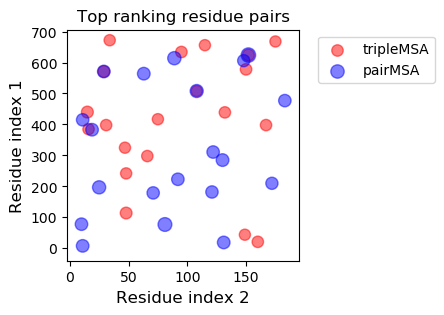

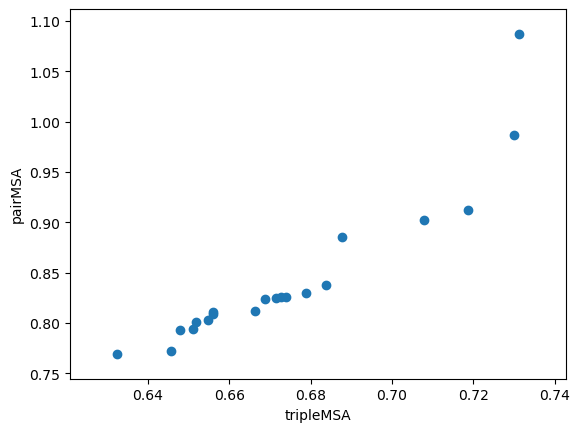

In [71]:
plt.figure(figsize=(3,3))
# scatterplot_ofTopDCAPos(tripleMSA_left2right_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
# scatterplot_ofTopDCAPos(pairMSA_left2right_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
print(tripleMSA_left2right_Betarray_topDCAList)
print(pairMSA_left2right_Betarray_topDCAList)
scatterplot_ofTopDCAPos(tripleMSA_left2right_Betarray_topDCAList,
                        color="red", alpha=0.5, marker="o", label="tripleMSA")
scatterplot_ofTopDCAPos(pairMSA_left2right_Betarray_topDCAList,
                        color="blue", alpha=0.5, marker="o", label="pairMSA")
# plt.legend(loc='best')
plt.title("Top ranking residue pairs")
plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )
plt.show()

scatterplot_ofTopDCAs(tripleMSA_left2right_Betarray_topDCAList,pairMSA_left2right_Betarray_topDCAList)
# plt.axline((0.64,0.8),slope=1,color="k", lw=1,ls="--")
# plt.axline((0, 0),slope=1,c="red")
plt.show()

In [34]:
len(pairMSA_left2right_Betarray_topDCAList)

60

In [35]:
# chain C to chain A
tripleMSA_left2middle_Betarray=tripleMSA_data_array[0:left_proLen,(left_proLen):(left_proLen+middle_proLen)]
tripleMSA_left2middle_Betarray_topDCAList=get_topRankingBetValue_dict_PosInSingleMSA_framArray(tripleMSA_left2middle_Betarray,topDCA_num)
print(tripleMSA_left2middle_Betarray_topDCAList)

pairMSA_left2middle_Betarray=get_pydcaFNAPC_betArray(Query_DCA_coevolutoin_path,left_pro,middle_pro,left_proLen,"_pydcaFNAPC_array")
pairMSA_left2middle_Betarray_topDCAList=get_topRankingBetValue_dict_PosInSingleMSA_framArray(pairMSA_left2middle_Betarray,topDCA_num)
print(pairMSA_left2middle_Betarray_topDCAList)




[2.6993, 29, 189, 2.4361, 90, 447, 2.2224, 25, 185, 1.8226, 48, 203, 1.766, 23, 197, 1.6331, 84, 352, 1.3057, 169, 10, 1.2175, 28, 182, 1.196, 25, 182, 1.1387, 174, 324, 1.1281, 78, 214, 1.055, 79, 214, 1.0293, 54, 243, 1.0293, 174, 248, 0.9429, 8, 49, 0.9198, 82, 243, 0.8959, 82, 237, 0.8912, 89, 553, 0.8679, 124, 353, 0.8631, 10, 75]
[3.678, 29, 189, 3.6136, 25, 185, 3.1428, 90, 447, 2.8668, 84, 352, 2.2911, 48, 203, 2.1729, 23, 197, 1.7105, 25, 182, 1.6992, 8, 49, 1.6915, 169, 10, 1.654, 28, 182, 1.6383, 54, 243, 1.5179, 174, 248, 1.4531, 10, 75, 1.4254, 174, 324, 1.3656, 12, 45, 1.3398, 25, 189, 1.3066, 94, 307, 1.2827, 14, 130, 1.2648, 82, 243, 1.2622, 79, 214]


20 20 20
20 20 20


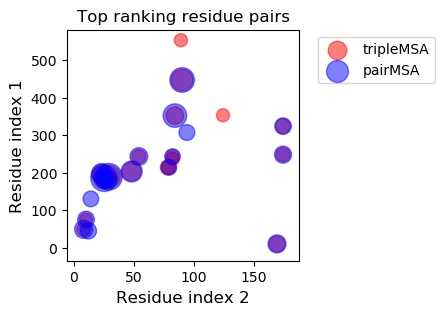

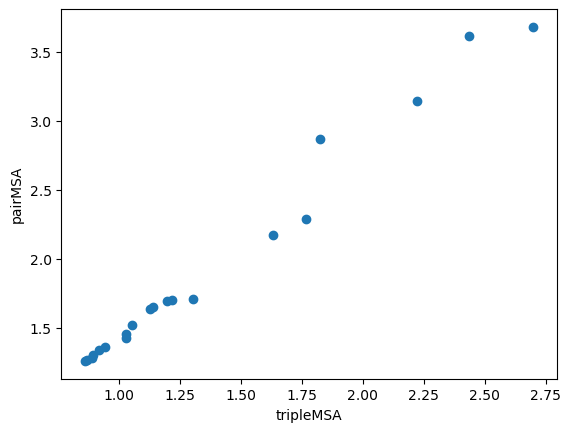

In [58]:
plt.figure(figsize=(3,3))
# scatterplot_ofTopDCAPos(tripleMSA_left2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
# scatterplot_ofTopDCAPos(pairMSA_left2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
scatterplot_ofTopDCAPos(tripleMSA_left2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="o",label="tripleMSA")
scatterplot_ofTopDCAPos(pairMSA_left2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="o",label="pairMSA")
# plt.legend(loc='best')
plt.title("Top ranking residue pairs")
plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )
plt.show()

scatterplot_ofTopDCAs(tripleMSA_left2middle_Betarray_topDCAList,pairMSA_left2middle_Betarray_topDCAList)
# plt.axline((1.0,1.5),slope=1,color="k", lw=1,ls="--")
plt.show()


In [37]:
# Chain B to Chain A
tripleMSA_right2middle_Betarray=tripleMSA_data_array[(left_proLen+middle_proLen):,(left_proLen):(left_proLen+middle_proLen)]
tripleMSA_right2middle_Betarray_topDCAList=get_topRankingBetValue_dict_PosInSingleMSA_framArray(tripleMSA_right2middle_Betarray,topDCA_num)
print(tripleMSA_right2middle_Betarray_topDCAList)

pairMSA_right2middle_Betarray=get_pydcaFNAPC_betArray(Query_DCA_coevolutoin_path,right_pro,middle_pro,right_proLen,"_pydcaFNAPC_array")
pairMSA_right2middle_Betarray_topDCAList=get_topRankingBetValue_dict_PosInSingleMSA_framArray(pairMSA_right2middle_Betarray,topDCA_num)
print(pairMSA_right2middle_Betarray_topDCAList)







[1.2883, 232, 541, 1.2062, 231, 541, 1.0746, 639, 240, 1.0678, 245, 441, 0.9361, 187, 92, 0.8983, 94, 319, 0.8977, 440, 440, 0.852, 243, 452, 0.8373, 68, 186, 0.8275, 170, 397, 0.8264, 68, 188, 0.8185, 556, 157, 0.807, 242, 444, 0.8017, 390, 110, 0.7924, 477, 355, 0.7844, 636, 383, 0.7687, 431, 206, 0.7687, 603, 131, 0.7568, 421, 274, 0.752, 440, 556]
[1.3823, 232, 541, 1.3141, 231, 541, 1.1843, 245, 441, 0.9539, 94, 319, 0.9427, 170, 397, 0.9252, 231, 425, 0.9109, 421, 274, 0.9061, 556, 157, 0.8934, 477, 355, 0.8762, 380, 420, 0.8665, 243, 452, 0.8665, 537, 422, 0.8654, 187, 92, 0.8398, 44, 96, 0.816, 581, 429, 0.8126, 465, 198, 0.8126, 653, 524, 0.8056, 603, 131, 0.8011, 68, 188, 0.7988, 653, 176]


20 20 20
20 20 20


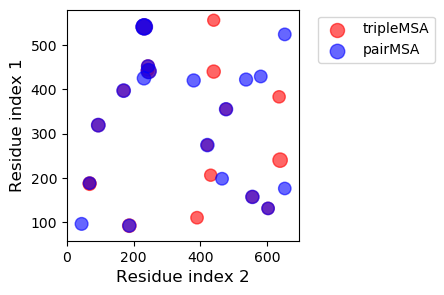

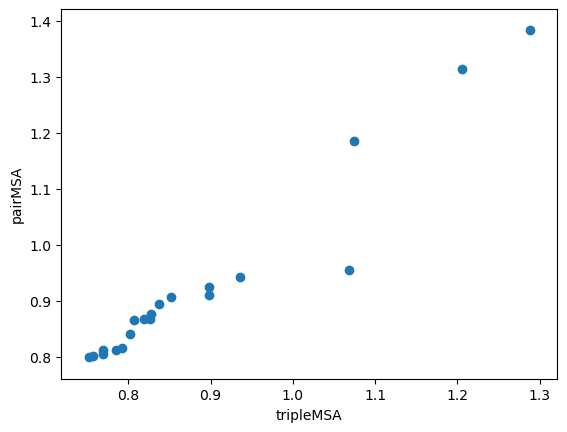

In [73]:
# yellow edges 
plt.figure(figsize=(3,3))
# scatterplot_ofTopDCAPos(tripleMSA_right2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
# scatterplot_ofTopDCAPos(pairMSA_right2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
scatterplot_ofTopDCAPos(tripleMSA_right2middle_Betarray_topDCAList,color="red" ,alpha=0.6,marker="o",label="tripleMSA")
scatterplot_ofTopDCAPos(pairMSA_right2middle_Betarray_topDCAList,color="blue" ,alpha=0.6,marker="o",label="pairMSA") # "o". "s"
# plt.legend(loc='best')
plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )
plt.show()

scatterplot_ofTopDCAs(tripleMSA_right2middle_Betarray_topDCAList,pairMSA_right2middle_Betarray_topDCAList)
# plt.axline((0.8,0.85),slope=1,color="k", lw=1,ls="--")
plt.show()


#### sup figure here 

20 20 20
20 20 20
20 20 20
20 20 20
20 20 20
20 20 20


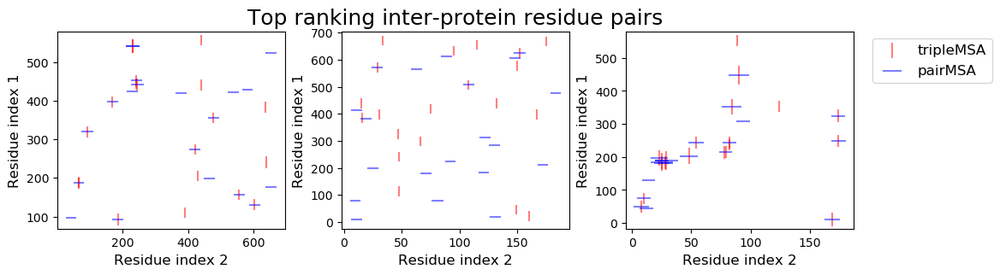

In [38]:

fig = plt.figure(figsize=(12,3))


axA = plt.subplot(1,3,1)
scatterplot_ofTopDCAPos(tripleMSA_right2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
scatterplot_ofTopDCAPos(pairMSA_right2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
# plt.legend(loc='best')
# plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )

axB= plt.subplot(1,3,2)
scatterplot_ofTopDCAPos(tripleMSA_left2right_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
scatterplot_ofTopDCAPos(pairMSA_left2right_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
plt.title("Top ranking inter-protein residue pairs",fontsize=18)
# plt.legend(loc='best')
# plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )


axC= plt.subplot(1,3,3)
scatterplot_ofTopDCAPos(tripleMSA_left2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
scatterplot_ofTopDCAPos(pairMSA_left2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")

#plt.legend(loc='best')
plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left',fontsize=12 )
plt.subplots_adjust(wspace=0.25, ) # plt.subplots_adjust(wspace=0.6, hspace=0.6)





plt.show()



In [41]:
from mpl_toolkits.mplot3d import Axes3D
# %matplotlib qt 
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

x_bar_width,y_bar_width 12 9.170146076054174


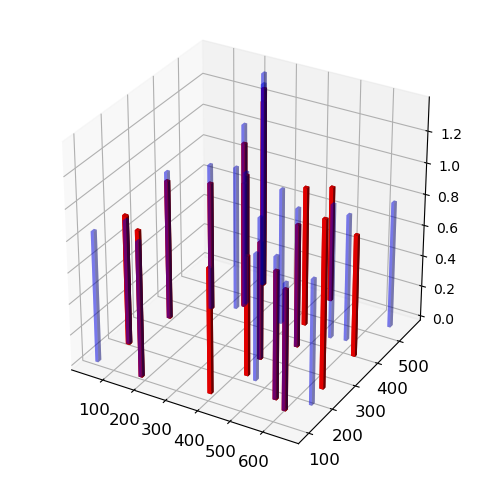

In [42]:
# python 3d barchar 
# https://www.youtube.com/watch?v=W94Kv8-c_5g
# https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# https://stackoverflow.com/questions/35246780/is-it-possible-to-superimpose-3-d-bar-charts-in-matplotlib
# https://stackoverflow.com/questions/38086972/stacked-3d-bar-chart-with-matplotlib

# this is for  B to A 
# left_pro,right_pro,middle_pro=('511145.b0696','511145.b0697','511145.b0698',)
# lenghtz are 190 680 557
# here left right , middle mean position in triple MSA
# chain C B A


paired_color="blue"#"#d7191c" #"red"
triple_color="red"#"#2c7bb6"#"blue"

# fig=plt.figure(figsize=(12,12))
fig=plt.figure(figsize=(6,6))
ax1=fig.add_subplot(111,projection="3d")


test_list1=tripleMSA_right2middle_Betarray_topDCAList
test_list2=pairMSA_right2middle_Betarray_topDCAList


x1 = [test_list1[i] for i in range(1,len(test_list1),3)]  # x coordinates of each bar
y1 = [test_list1[i] for i in range(2,len(test_list1),3)]  # y coordinates of each bar
z1 = [0,]*len(x1)  # z coordinates of each bar
x2 = [test_list2[i] for i in range(1,len(test_list2),3)]  # x coordinates of each bar
y2 = [test_list2[i] for i in range(2,len(test_list2),3)]  # y coordinates of each bar
z2 = [0, ]*len(x2)  # z coordinates of each bar


# ax1.get_ylim(),ax1.get_xlim()
# ((68.50638489208633, 585.365917266187), (13.25638489208633, 689.615917266187))
max_x=585.37-68.51#max(x1+x2)
max_y=689.62-13.26#max(y1+y2)
x_bar_width=12#5#20
y_bar_width=x_bar_width*(max_x/max_y)#5#10
print("x_bar_width,y_bar_width",x_bar_width,y_bar_width)
DCA_num=20




dz1 = [test_list1[i] for i in range(0,len(test_list1),3)] # test_list1[i]*100         # Height of each bar
dx1 = [x_bar_width]*len(dz1)  # Width of each bar
dy1 = [y_bar_width]*len(dz1)  
ax1.bar3d(x1,y1,z1,dx1,dy1,dz1,
          color = triple_color,#alpha = 0.3,
         )





dz2 = [test_list2[i] for i in range(0,len(test_list2),3)] # test_list1[i]*100         # Height of each bar
dx2 = [y_bar_width]*len(dz2)  # Width of each bar
dy2 = [x_bar_width]*len(dz2)  # Depth of each bar
ax1.bar3d(x2,y2,z2,dx2,dy2,dz2,
          color = paired_color,alpha = 0.3,
         )

#https://matplotlib.org/stable/api/_as_gen/mpl_toolkits.mplot3d.axes3d.Axes3D.view_init.html
# ax1.set_xlim3d(0, max(x1+y1))
# ax1.set_ylim3d(0, max(x1+y1))
# ax1.view_init(elev=30,azim=90)#elev=100., azim=0

# ax1.set_xticks([])
# ax1.set_yticks([])
# ax1.set_zticks([])


# ax1.set_xlabel("Residue index1",fontsize=12) # loc='center',
# ax1.set_ylabel("Residue index2",fontsize=12)
# ax1.set_zlabel("DCA score",fontsize=12)
ax1.grid(visible=False)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
# ax1.set_zticks((),fontsize=12)

# plt.tight_layout()

plt.show()


fig.savefig("/mnt/mnemo5/tao/temp_figures/Fig3_1.pdf", dpi=600)



x_bar_width,y_bar_width 3 11.406039223824841


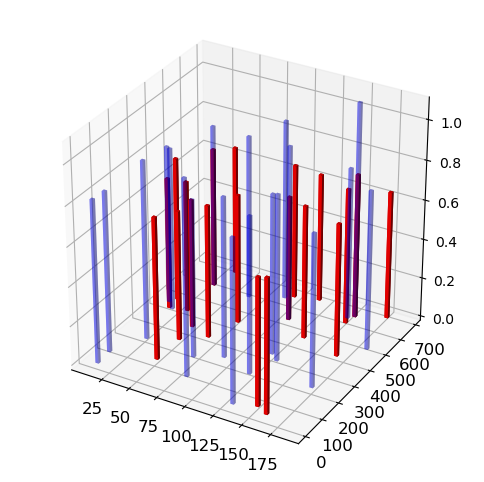

In [43]:
# python 3d barchar 
# https://www.youtube.com/watch?v=W94Kv8-c_5g
# https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# https://stackoverflow.com/questions/35246780/is-it-possible-to-superimpose-3-d-bar-charts-in-matplotlib
# https://stackoverflow.com/questions/38086972/stacked-3d-bar-chart-with-matplotlib

# fig=plt.figure(figsize=(12,12))
fig=plt.figure(figsize=(6,6))
ax1=fig.add_subplot(111,projection="3d")

test_list1=tripleMSA_left2right_Betarray_topDCAList
test_list2=pairMSA_left2right_Betarray_topDCAList


x1 = [test_list1[i] for i in range(1,len(test_list1),3)]  # x coordinates of each bar
y1 = [test_list1[i] for i in range(2,len(test_list1),3)]  # y coordinates of each bar
z1 = [0,]*len(x1)  # z coordinates of each bar
x2 = [test_list2[i] for i in range(1,len(test_list2),3)]  # x coordinates of each bar
y2 = [test_list2[i] for i in range(2,len(test_list2),3)]  # y coordinates of each bar
z2 = [0, ]*len(x2)  # z coordinates of each bar


# ((-25.31116071428572, 707.5343750000001), (1.2388392857142865, 193.984375))
max_x=707.5+25.3#max(x1+x2)
max_y=193.98-1.24#max(y1+y2)
x_bar_width=3#5#5#20
y_bar_width=x_bar_width*(max_x/max_y)#5#10
print("x_bar_width,y_bar_width",x_bar_width,y_bar_width)
DCA_num=20


dz1 = [test_list1[i] for i in range(0,len(test_list1),3)] # test_list1[i]*100         # Height of each bar
dx1 = [x_bar_width]*len(dz1)  # Width of each bar
dy1 = [y_bar_width]*len(dz1)  
ax1.bar3d(x1,y1,z1,dx1,dy1,dz1,
          color = triple_color, #alpha = 0.3,
         )



dz2 = [test_list2[i] for i in range(0,len(test_list2),3)] # test_list1[i]*100         # Height of each bar
dx2 = [x_bar_width]*len(dz2)  # Width of each bar
dy2 = [y_bar_width]*len(dz2)  # Depth of each bar
ax1.bar3d(x2,y2,z2,dx2,dy2,dz2,
          color = paired_color, alpha = 0.3,
         )



# ax1.set_xlim3d(0, max(x1+y1))
# ax1.set_ylim3d(0, max(x1+y1))
# ax1.view_init(elev=60,azim=25)#elev=100., azim=0
# ax1.set_xlabel("Residue index1",fontsize=12) # loc='center',
# ax1.set_ylabel("Residue index2",fontsize=12)
# ax1.set_zlabel("DCA score",fontsize=12)
ax1.grid(visible=False)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
# ax1.set_zticks((),fontsize=12)
# plt.tight_layout()
plt.show()


fig.savefig("/mnt/mnemo5/tao/temp_figures/Fig3_2.pdf", dpi=600)


x_bar_width,y_bar_width 3 9.309297520661156


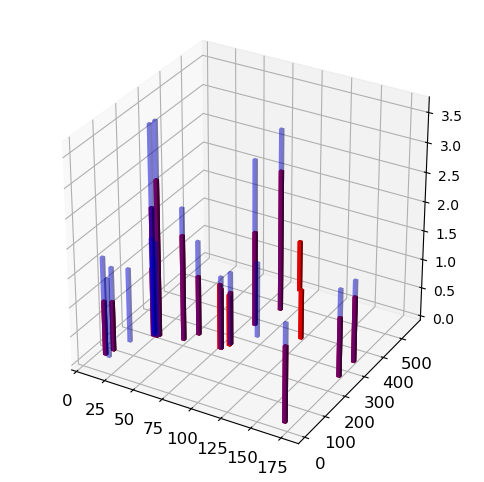

In [44]:
# python 3d barchar 
# https://www.youtube.com/watch?v=W94Kv8-c_5g
# https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# https://stackoverflow.com/questions/35246780/is-it-possible-to-superimpose-3-d-bar-charts-in-matplotlib
# https://stackoverflow.com/questions/38086972/stacked-3d-bar-chart-with-matplotlib

# fig=plt.figure(figsize=(12,12))
fig=plt.figure(figsize=(6,6))
ax1=fig.add_subplot(111,projection="3d")


test_list1=tripleMSA_left2middle_Betarray_topDCAList
test_list2=pairMSA_left2middle_Betarray_topDCAList


x1 = [test_list1[i] for i in range(1,len(test_list1),3)]  # x coordinates of each bar
y1 = [test_list1[i] for i in range(2,len(test_list1),3)]  # y coordinates of each bar
z1 = [0,]*len(x1)  # z coordinates of each bar
x2 = [test_list2[i] for i in range(1,len(test_list2),3)]  # x coordinates of each bar
y2 = [test_list2[i] for i in range(2,len(test_list2),3)]  # y coordinates of each bar
z2 = [0, ]*len(x2)  # z coordinates of each bar


# ax1.get_ylim(),ax1.get_xlim()
# ((-17.30732368896926, 583.4537974683544), (-0.8000000000000007, 192.8))
max_x=583.45+17.31#max(x1+x2)
max_y=192.8+0.80#max(y1+y2)
x_bar_width=3#5#10#5#20
y_bar_width=x_bar_width*(max_x/max_y)#5#10
print("x_bar_width,y_bar_width",x_bar_width,y_bar_width)
DCA_num=20



dz1 = [test_list1[i] for i in range(0,len(test_list1),3)] # test_list1[i]*100         # Height of each bar
dx1 = [x_bar_width]*len(dz1)  # Width of each bar
dy1 = [y_bar_width]*len(dz1)  
ax1.bar3d(x1,y1,z1,dx1,dy1,dz1,
          color = triple_color, #alpha = 0.3,
         )


dz2 = [test_list2[i] for i in range(0,len(test_list2),3)] # test_list1[i]*100         # Height of each bar
dx2 = [x_bar_width]*len(dz2)  # Width of each bar
dy2 = [y_bar_width]*len(dz2)  # Depth of each bar
ax1.bar3d(x2,y2,z2,dx2,dy2,dz2,
          color = paired_color, alpha = 0.3,# 0.3
         )

# ax1.set_xlim3d(0, max(x1+y1))
# ax1.set_ylim3d(0, max(x1+y1))


# plt.tight_layout()
# ax1.set_xlabel("Residue index1",fontsize=12) # loc='center',
# ax1.set_ylabel("Residue index2",fontsize=12)
# ax1.set_zlabel("DCA score",fontsize=12)
ax1.grid(visible=False)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()



fig.savefig("/mnt/mnemo5/tao/temp_figures/Fig3_3.pdf", dpi=600)



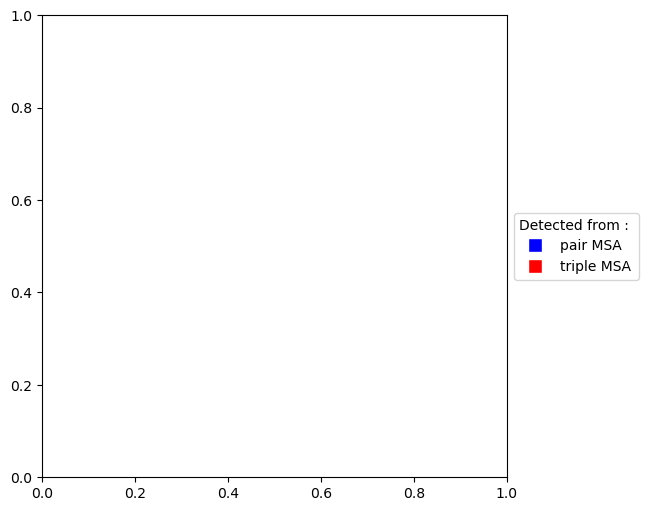

In [45]:
# python 3d barchar 
# https://www.youtube.com/watch?v=W94Kv8-c_5g
# https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# https://stackoverflow.com/questions/35246780/is-it-possible-to-superimpose-3-d-bar-charts-in-matplotlib
# https://stackoverflow.com/questions/38086972/stacked-3d-bar-chart-with-matplotlib

# fig=plt.figure(figsize=(12,12))
fig=plt.figure(figsize=(6,6))


legend_elements = [Line2D([0], [0],  marker='s', color='w', label='pair MSA',# 'Yes,579',
                           markerfacecolor=paired_color, markersize=10,
                         ),
                   
                   Line2D([0], [0], marker='s',color='w',label='triple MSA',
                           markerfacecolor=triple_color, markersize=10,
                         ),
                  ]


plt.legend(loc='center left', bbox_to_anchor=(1, 0.5),
          handles=legend_elements,
           title="Detected from : ",
          )


fig.savefig("/mnt/mnemo5/tao/temp_figures/Fig3_legend.pdf", dpi=600)



In [44]:
# # python 3d barchar 
# # https://www.youtube.com/watch?v=W94Kv8-c_5g
# # https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# # https://stackoverflow.com/questions/35246780/is-it-possible-to-superimpose-3-d-bar-charts-in-matplotlib
# # https://stackoverflow.com/questions/38086972/stacked-3d-bar-chart-with-matplotlib

# fig=plt.figure()
# ax1=fig.add_subplot(111,projection="3d")

# bar_width=30
# DCA_num=20

# test_list1=tripleMSA_right2middle_Betarray_topDCAList
# test_list2=pairMSA_right2middle_Betarray_topDCAList



# x1 = [test_list1[i] for i in range(1,len(test_list1),3)]  # x coordinates of each bar
# y1 = [test_list1[i] for i in range(2,len(test_list1),3)]  # y coordinates of each bar
# z1 = [0,]*len(x1)  # z coordinates of each bar
# dz1 = [test_list1[i] for i in range(0,len(test_list1),3)] # test_list1[i]*100         # Height of each bar
# dx1 = [bar_width]*len(dz1)  # Width of each bar
# dy1 = [bar_width]*len(dz1)  
# ax1.bar3d(x1,y1,z1,dy1,dy1,dz1,
#           color = 'red', alpha = 0.3,
#          )


# x2 = [test_list2[i] for i in range(1,len(test_list2),3)]  # x coordinates of each bar
# y2 = [test_list2[i] for i in range(2,len(test_list2),3)]  # y coordinates of each bar
# z2 = [0, ]*len(x2)  # z coordinates of each bar
# for i in range(DCA_num):
#     if (x1[i]==x2[i])and(y1[i]==y2[i]):
#         z2[i]= z2[i]+dz1[i]
# dz2 = [test_list2[i] for i in range(0,len(test_list2),3)] # test_list1[i]*100         # Height of each bar
# dx2 = [bar_width]*len(dz2)  # Width of each bar
# dy2 = [bar_width]*len(dz2)  # Depth of each bar
# ax1.bar3d(x2,y2,z2,dy2,dy2,dz2,
#           color = 'green', alpha = 0.3,
#          )

# plt.show()



In [45]:
# # python 3d barchar 
# # https://www.youtube.com/watch?v=W94Kv8-c_5g
# # https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# # https://stackoverflow.com/questions/35246780/is-it-possible-to-superimpose-3-d-bar-charts-in-matplotlib
# # https://stackoverflow.com/questions/38086972/stacked-3d-bar-chart-with-matplotlib

# fig=plt.figure()
# ax1=fig.add_subplot(111,projection="3d")

# bar_width=10
# DCA_num=20

# test_list1=tripleMSA_left2right_Betarray_topDCAList
# test_list2=pairMSA_left2right_Betarray_topDCAList



# x1 = [test_list1[i] for i in range(1,len(test_list1),3)]  # x coordinates of each bar
# y1 = [test_list1[i] for i in range(2,len(test_list1),3)]  # y coordinates of each bar
# z1 = [0,]*len(x1)  # z coordinates of each bar
# dz1 = [test_list1[i] for i in range(0,len(test_list1),3)] # test_list1[i]*100         # Height of each bar
# dx1 = [bar_width]*len(dz1)  # Width of each bar
# dy1 = [bar_width]*len(dz1)  
# ax1.bar3d(x1,y1,z1,dy1,dy1,dz1,
#           color = 'red', alpha = 0.3,
#          )


# x2 = [test_list2[i] for i in range(1,len(test_list2),3)]  # x coordinates of each bar
# y2 = [test_list2[i] for i in range(2,len(test_list2),3)]  # y coordinates of each bar
# z2 = [0, ]*len(x2)  # z coordinates of each bar
# for i in range(DCA_num):
#     if (x1[i]==x2[i])and(y1[i]==y2[i]):
#         z2[i]= z2[i]+dz1[i]
# dz2 = [test_list2[i] for i in range(0,len(test_list2),3)] # test_list1[i]*100         # Height of each bar
# dx2 = [bar_width]*len(dz2)  # Width of each bar
# dy2 = [bar_width]*len(dz2)  # Depth of each bar
# ax1.bar3d(x2,y2,z2,dy2,dy2,dz2,
#           color = 'green', alpha = 0.3,
#          )

# plt.show()



In [46]:
# # python 3d barchar 
# # https://www.youtube.com/watch?v=W94Kv8-c_5g
# # https://stackoverflow.com/questions/24736758/parameters-required-by-bar3d-with-pythonb
# # https://stackoverflow.com/questions/49981313/rotate-interactively-a-3d-plot-in-python-matplotlib-jupyter-notebook

# bar_width=10
# fig=plt.figure()
# ax1=fig.add_subplot(111,projection="3d")


# test_list=tripleMSA_left2right_Betarray_topDCAList
# x = [test_list[i] for i in range(1,len(test_list),3)]  # x coordinates of each bar
# y = [test_list[i] for i in range(2,len(test_list),3)]  # y coordinates of each bar
# z = [0, ]*len(x)  # z coordinates of each bar
# dz = [test_list[i] for i in range(0,len(test_list),3)] # test_list[i]*100         # Height of each bar
# dx = [bar_width]*len(dz)  # Width of each bar
# dy = [bar_width]*len(dz)  # Depth of each bar
# ax1.bar3d(x,y,z,dy,dy,dz,
#           # color = '#e34a33', alpha = 1,
#          )


# test_list=pairMSA_left2right_Betarray_topDCAList
# x = [test_list[i] for i in range(1,len(test_list),3)]  # x coordinates of each bar
# y = [test_list[i] for i in range(2,len(test_list),3)]  # y coordinates of each bar
# z = [0, ]*len(x)  # z coordinates of each bar
# dz = [test_list[i] for i in range(0,len(test_list),3)] # test_list[i]*100         # Height of each bar
# dx = [bar_width]*len(dz)  # Width of each bar
# dy = [bar_width]*len(dz)  # Depth of each bar
# ax1.bar3d(x,y,z,dy,dy,dz,
#           # color = '#fee8c8', alpha = 0.5,
#          )

# plt.show()



In [47]:
# old
# fig = plt.figure(figsize=(12,3))


# axA = plt.subplot(1,3,1)
# scatterplot_ofTopDCAPos(tripleMSA_right2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
# scatterplot_ofTopDCAPos(pairMSA_right2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
# # plt.legend(loc='best')
# # plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )

# axB= plt.subplot(1,3,2)
# scatterplot_ofTopDCAPos(tripleMSA_left2right_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
# scatterplot_ofTopDCAPos(pairMSA_left2right_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")
# plt.title("Top ranking inter-protein residue pairs",fontsize=18)
# # plt.legend(loc='best')
# # plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left' )


# axC= plt.subplot(1,3,3)
# scatterplot_ofTopDCAPos(tripleMSA_left2middle_Betarray_topDCAList,color="red" ,alpha=0.5,marker="|",label="tripleMSA")
# scatterplot_ofTopDCAPos(pairMSA_left2middle_Betarray_topDCAList,color="blue" ,alpha=0.5,marker="_",label="pairMSA")

# #plt.legend(loc='best')
# plt.legend( bbox_to_anchor=(1.05, 1), loc='upper left',fontsize=12 )
# plt.subplots_adjust(wspace=0.25, ) # plt.subplots_adjust(wspace=0.6, hspace=0.6)





# plt.show()

